# Fake Text Detection with Steering Vectors:

Это вторая часть исследования с моделью microsoft/phi-2. При тренировке данной модели были использованы синтетическеи данные, поэтому интересно проверить, как модель отличает "свои" тексты (или тексты своих коллег) от человеческих.
- Фейковые и реальные тексты для построения стиринг векторов взяты из COLING (https://huggingface.co/datasets/Jinyan1/COLING_2025_MGT_en).
- Для активаци и стиринг вектороф были созданы графики магнитуды, косинусного подобия от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток и график дисперсии классов по слоям.
- Для задачи детектирования фейковых текстов был изначально взят домен текстов с reddit - тренировачное и тестовое множества. Из активации стоев и стиринг ветороа былы посчитаны проекции фейковости и обучены три классификатора: логистическая регрессия, random forest и SVM.
- Для каждого из классификаторов были постоены графики и посчитаны основные метрики. Классификаторы были обучены на каждом слое, чтобы понять какая активация какого слоя лучше всего подходит для детекции фейковых текстов.
- Пункт выше также был проделан для тренировки классификаторов на стиринг векторах одного домена (в моем случае reddit) и теста на текстах другого домена (в моем случае домены financial, medical). Идея переноса на именно эти домены возникла по причине специфичности этих текстов: фининсовые и медицинские тексты имеют определенную структуру и термины, которых необходимо придерживаться - как человеку, так и машине. Это привносит определенную сложность в детектирование таких текстов, т.к. кретивность в этих текстах неуместна и человеку приходится придерживаться определенного стиля и "стандарта".  

### Загрузка необходимых библиотек: при первом запуске необходимо создать venv (virtual environment) и выбрать его для последующей работы. В него необходимо установить библиотеки: это можно сделать либо через pip следующих сточек команд, либо через терминал из requirements.txt.

In [ ]:
#%pip install -U datasets steering-vectors accelerate bitsandbytes
# #%pip install umap-learn
# #%pip install transformers

In [ ]:
import torch
print(torch.version.cuda)
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No CUDA device")
import steering_vectors
from transformers import AutoTokenizer, AutoModelForCausalLM
import datasets
import seaborn as sns
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.metrics import roc_auc_score
from copy import copy

import math
from collections.abc import Iterable
from dataclasses import dataclass

from tqdm import tqdm
from transformers import PreTrainedModel as Model
from transformers import PreTrainedTokenizerBase as Tokenizer
from typing import Dict, List, Tuple, Optional, Any
import pickle
import os
import sys
import logging

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import umap

#from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import StandardScaler
from scipy.stats import pearsonr
from pprint import pprint
import joblib
import shutil
from datasets import Dataset, concatenate_datasets
from scipy.spatial.distance import pdist
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

12.1
True
1
NVIDIA GeForce RTX 4090


### Для вычисления стиринг векторов, их проекций и их сравнения, а также для создания визуализации я написала специальные функции, но они получились большими. Поэтому их можно найти в отбельном модуле:

In [ ]:
sys.path.append('..') # Путь к папке compute_steering_vectors
from compute_steering_vectors import calculate_steering_vector

### Для создания визуализаций я также написала функцию, которые можно найти в отдельном файле visualisation_function.py в папке visualize_computed_steering_vectors.

In [ ]:
sys.path.append('..') # Путь к папке visualize_computed_steering_vectors
from visualize_computed_steering_vectors import visualize_steering_vectors

In [1]:
#import huggingface_hub
#huggingface_hub.notebook_login()

In [ ]:
device = torch.device(str("cuda:0") if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# Загрузка данных и их обработка, как в первом эксперименте с llama-2-7b:

In [ ]:
dataset = datasets.load_dataset('Jinyan1/COLING_2025_MGT_en') #Jinyan1/COLING_2025_MGT_multingual

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 610767
    })
    dev: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 261758
    })
})

In [ ]:
print("Список доменов:")
print(dataset["train"].unique('source'))
print()
print("Список поддоменов:")
print(dataset["train"].unique('sub_source'))
print()
print("Список моделей-генераторов:")
print(dataset["train"].unique('model'))
print()
print("Модели-генераторы в train и dev подмножествах совпадают:")
print(set(dataset["train"].unique('model')) == set(dataset["dev"].unique('model')))

Список доменов:
['m4gt', 'mage', 'hc3']

Список поддоменов:
['reddit', 'squad', 'yelp', 'xsum', 'wikipedia', 'reddit_eli5', 'wp', 'roct', 'outfox', 'wikihow', 'sci_gen', 'eli5', 'arxiv', 'cmv', 'tldr', 'peerread', 'hswag', 'finance', 'open_qa', 'imdb', 'wiki_csai', 'dialogsum', 'medicine', 'cnn', 'pubmed']

Список моделей-генераторов:
['llama3-8b', 'human', 'gpt-35', 'GLM130B', '65B', 'text-davinci-003', 'gpt4', 'gpt4o', '7B', 'opt_350m', 'gpt-3.5-turbo', 'cohere', 'davinci', 'mixtral-8x7b', 'gpt_j', 'opt_2.7b', 'flan_t5_small', 'flan_t5_xxl', 'bloomz', 't0_11b', 'opt_iml_max_1.3b', 'text-davinci-002', 'flan_t5_base', 'flan_t5_large', 'bloom_7b', 'opt_30b', 'opt_iml_30b', 'opt_1.3b', 'gpt_neox', 'dolly', '30B', 't0_3b', 'opt_6.7b', 'llama3-70b', 'gemma-7b-it', 'flan_t5_xl', '13B', 'gemma2-9b-it', 'opt_13b', 'dolly-v2-12b', 'opt_125m']

Модели-генераторы в train и dev подмножествах совпадают:
True


# Визуализацию данных можно увидеть в эксперименте с первой моделью в папке "notebooks" в файле "FakeTextDetectionWithSteering_llama.ipynb".

# Часть 1: Эксперимент -1 с моделью для стиринг векторов будет - ***microsoft/phi-2***. Этой модели также нет в выборке. Как и для эксперимента с llama для начальной детекции на одном домене буду использовать часть с reddit.

In [ ]:
models_of_interest = {"train": ["human", "gpt-3.5-turbo", "gpt4", "llama3-70b"],
                      "dev": ["human", "mixtral-8x7b", "gpt4o", "gemma2-9b-it"]}
sources_of_interest = {"train": ["reddit"],
                       "dev": ["reddit"]}

splits = {"train": None, "dev": None}

for split in splits:
    splits[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 28774
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 11306
 })}

## Закрузка microsoft/phi-2.

In [ ]:
def get_model_and_tokenizer(model_name: str):
    tokenizer = AutoTokenizer.from_pretrained(model_name, trust_remote_code=True)
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype="auto", trust_remote_code=True) #torch_dtype="auto", trust_remote_code=True
    return model, tokenizer

In [ ]:
model_name = f"microsoft/phi-2"  #f"microsoft/Phi-3-small-8k-instruct"
model, tokenizer = get_model_and_tokenizer(model_name)

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

## Посмотрим на структуру модели microsoft/phi-2:

In [ ]:
print(model)
print(tokenizer)

PhiForCausalLM(
  (model): PhiModel(
    (embed_tokens): Embedding(51200, 2560)
    (layers): ModuleList(
      (0-31): 32 x PhiDecoderLayer(
        (self_attn): PhiAttention(
          (q_proj): Linear(in_features=2560, out_features=2560, bias=True)
          (k_proj): Linear(in_features=2560, out_features=2560, bias=True)
          (v_proj): Linear(in_features=2560, out_features=2560, bias=True)
          (dense): Linear(in_features=2560, out_features=2560, bias=True)
        )
        (mlp): PhiMLP(
          (activation_fn): NewGELUActivation()
          (fc1): Linear(in_features=2560, out_features=10240, bias=True)
          (fc2): Linear(in_features=10240, out_features=2560, bias=True)
        )
        (input_layernorm): LayerNorm((2560,), eps=1e-05, elementwise_affine=True)
        (resid_dropout): Dropout(p=0.1, inplace=False)
      )
    )
    (rotary_emb): PhiRotaryEmbedding()
    (embed_dropout): Dropout(p=0.0, inplace=False)
    (final_layernorm): LayerNorm((2560,), eps=1

## Пайплайн:
    - collect_acrivations() пропускаут через себя каждый текст выборки - тренировочной и тестовой, и аккумилирует функции активаций.
    - calculate_steering_from_activations() считает стиринг векторы "фековости" для каждого слоя модели.
    - extraxt_and_organize_data() собирает данные с лейблами 0 (реальные) и 1 (фейковый).
    - calculate_steering_vector() считает стиринг векторы.
Параметор *only_dev* регулирует возможность посчитать steering векторы: релевантно для переноса домена, т.к. steering вектор будет считаться на одном множестве, а тестить будем на другом.

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=splits,
        save_dir="../computed_steering_data/microsoftPhi2_steering_vectors",
        max_length=2048,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev=False,
        device=device,
    )

print("Steering vector calculation completed!")
print(f"Overall steering vector shape: {results['steering_vectors']['overall'].shape}")

# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 20353 real, 8421 fake texts
INFO:__main__:Dev data: 8663 real, 2643 fake texts


train: 20353 real texts, 8421 fake texts
dev: 8663 real texts, 2643 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 20353 real texts from train
Processing texts: 100%|██████████| 20353/20353 [11:59<00:00, 28.27it/s]
INFO:__main__:Saving activations to microsoftPhi_steering_vectors\train_real_activations.pkl
INFO:__main__:Processing 8421 fake texts from train
Processing texts: 100%|██████████| 8421/8421 [04:43<00:00, 29.70it/s]
INFO:__main__:Saving activations to microsoftPhi_steering_vectors\train_fake_activations.pkl
Processing data splits:  50%|█████     | 1/2 [16:48<16:48, 1008.30s/it]INFO:__main__:Processing dev data...
INFO:__main__:Processing 8663 real texts from dev
Processing texts: 100%|██████████| 8663/8663 [05:07<00:00, 28.13it/s]
INFO:__main__:Saving activations to microsoftPhi_steering_vectors\dev_real_activations.pkl
INFO:__main__:Processing 2643 fake texts from dev
Processing texts: 100%|██████████| 2643/2643 [01:34<00:00, 28.04it/s]
INFO:__main__:Saving activat

Steering vector calculation completed!
Overall steering vector shape: torch.Size([2560])

Detailed results:
train_real_count: 20353
train_fake_count: 8421
dev_real_count: 8663
dev_fake_count: 2643
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
#/content/llama_steering_vectors

## Визуализация полученных steering векторов и активаций. Функции и их подродное описание можно найти в модуле "visualize_computed_steering_vectors". На графиках ниже создам магнитуду веторов, косинусное подобие от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток. По каждому слою построю график дисперсии классов.

Loading results...
Loaded 4 activation sets


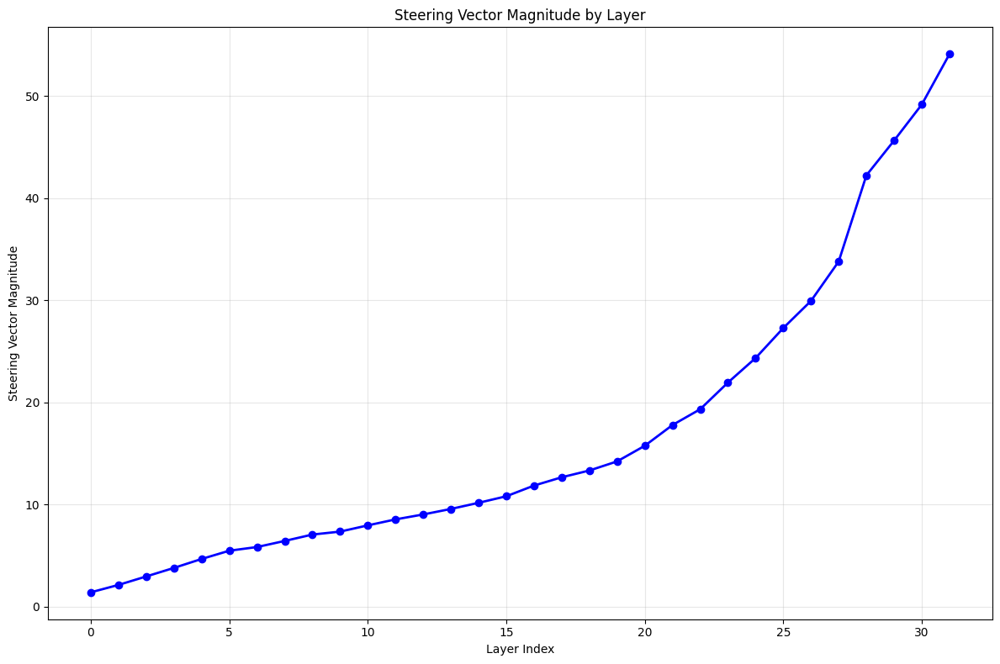

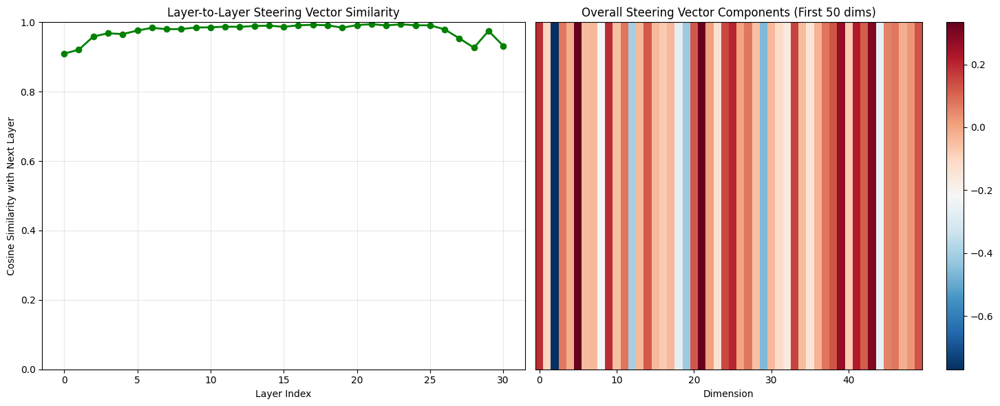

c:\Users\DarMan\stepik\Projekt_2Sem_DLS\Projekt\notebooks\..\visualize_computed_steering_vectors\visualisation_funktion.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(2, 2, figsize=(16, 12))


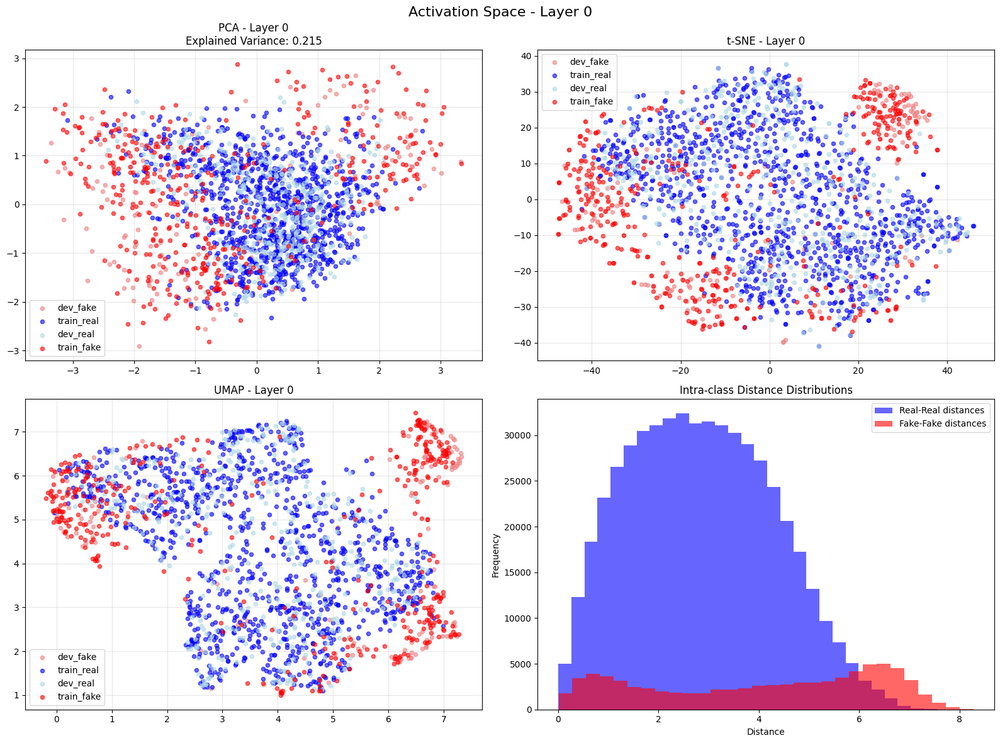

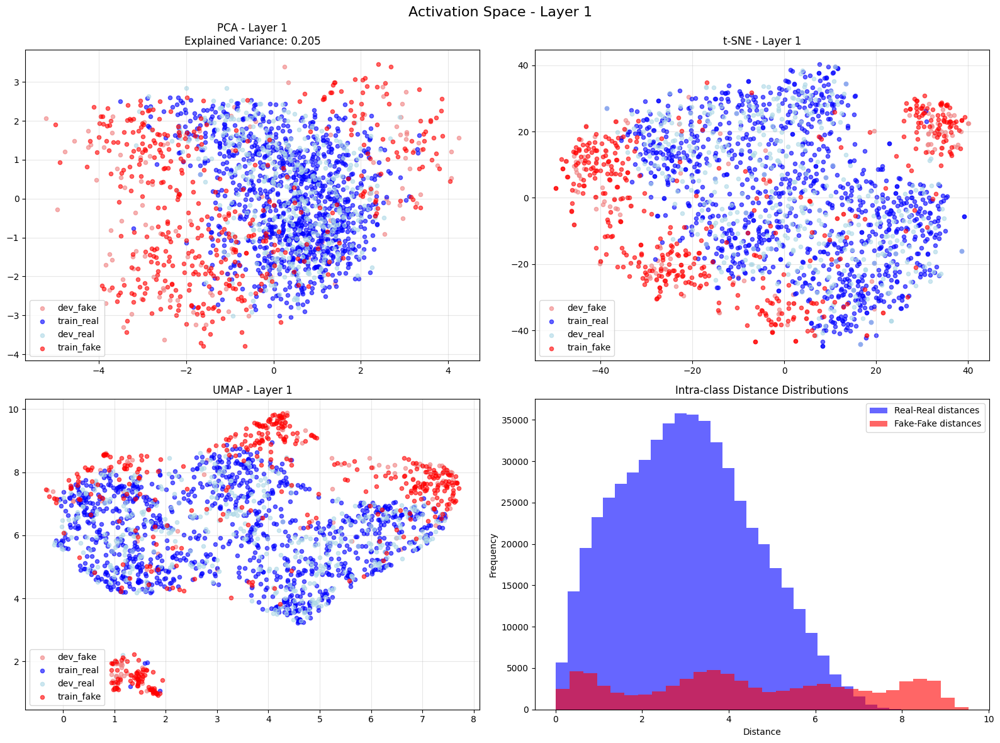

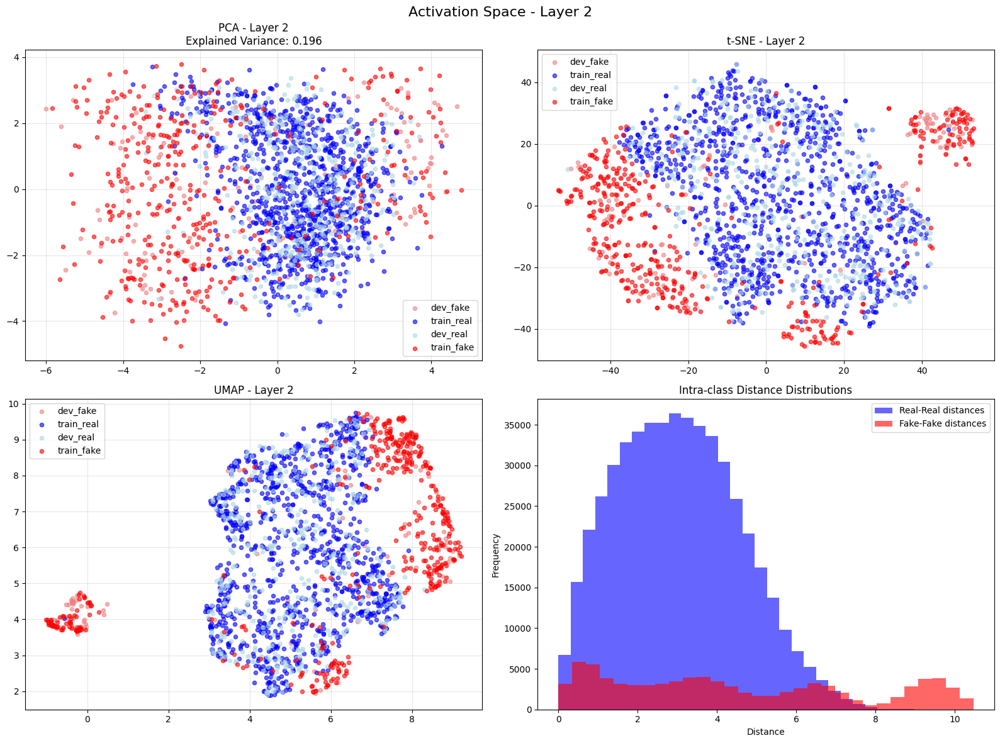

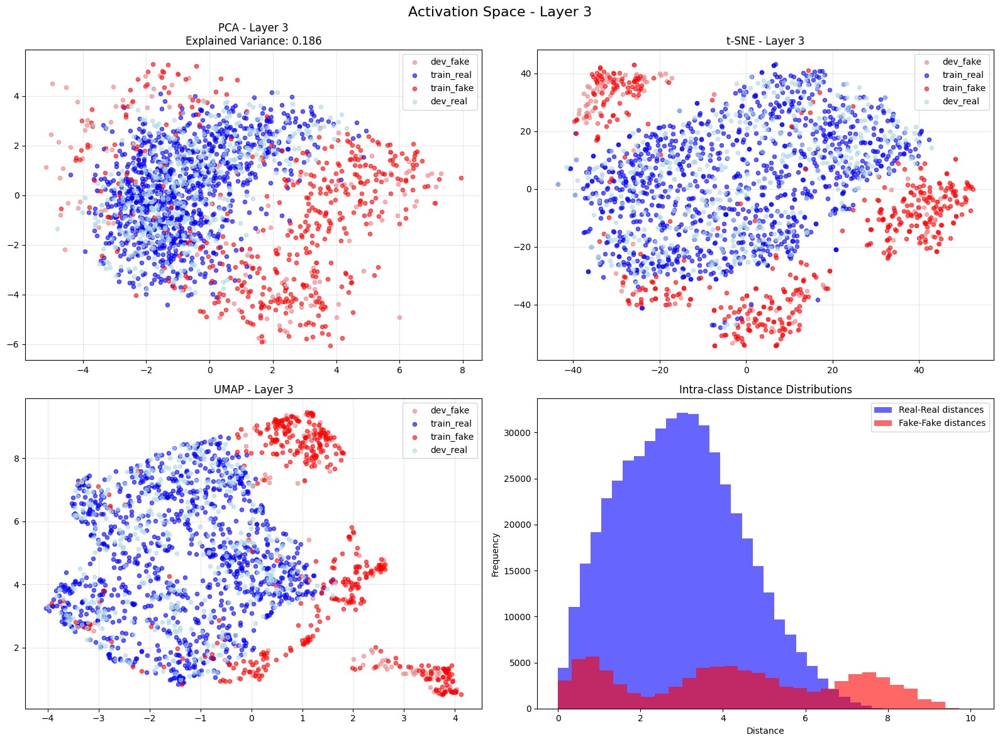

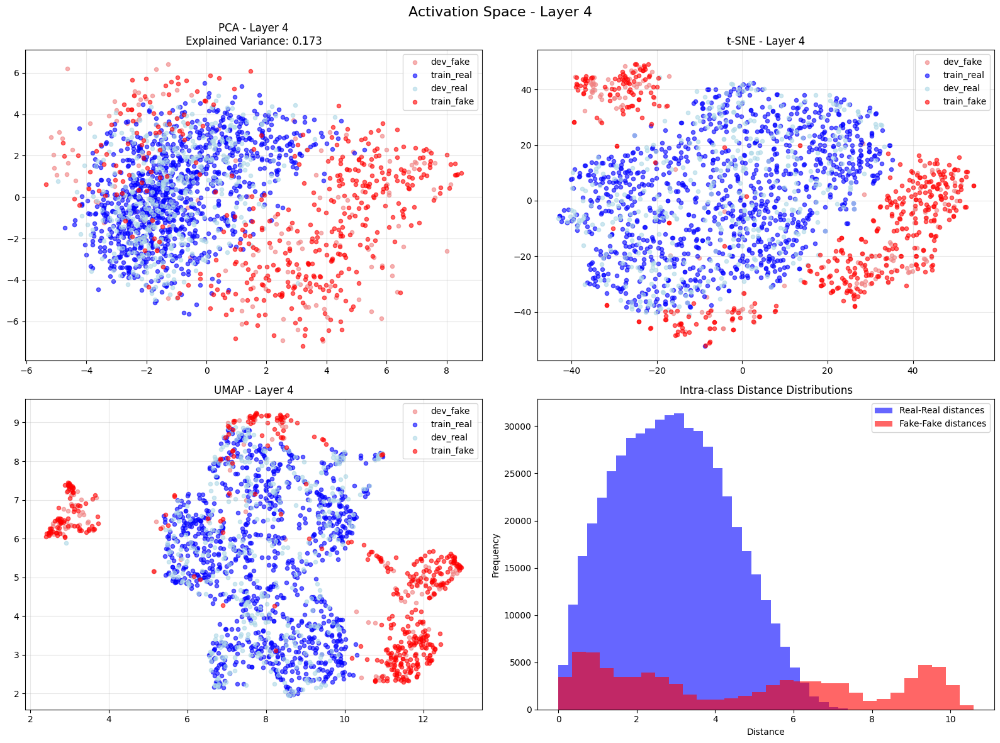

...

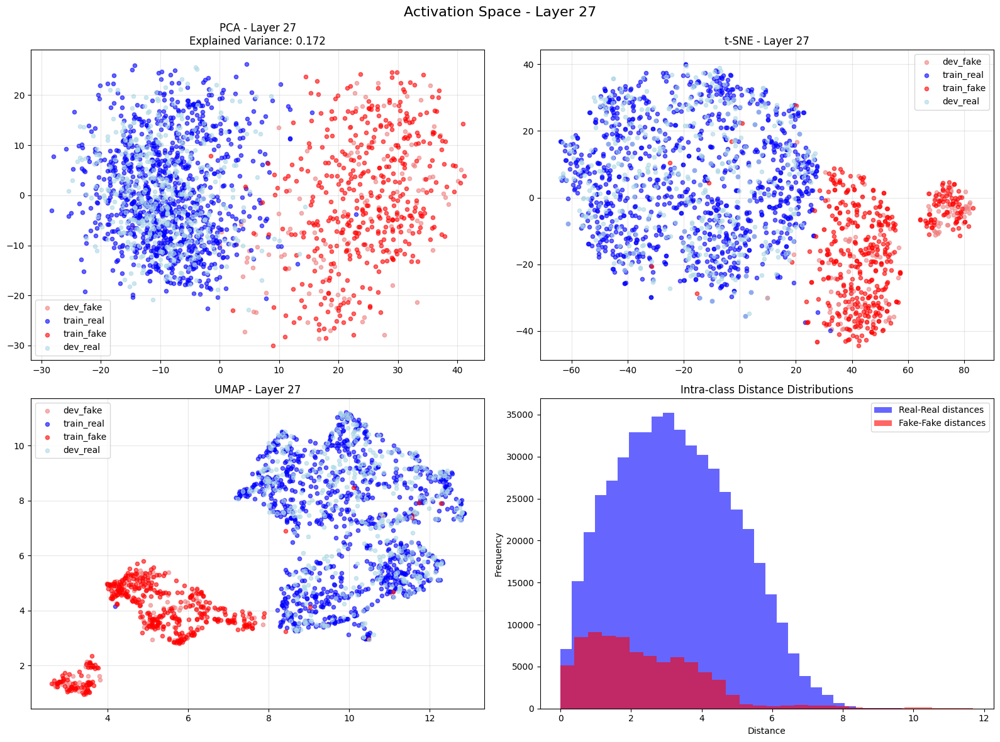

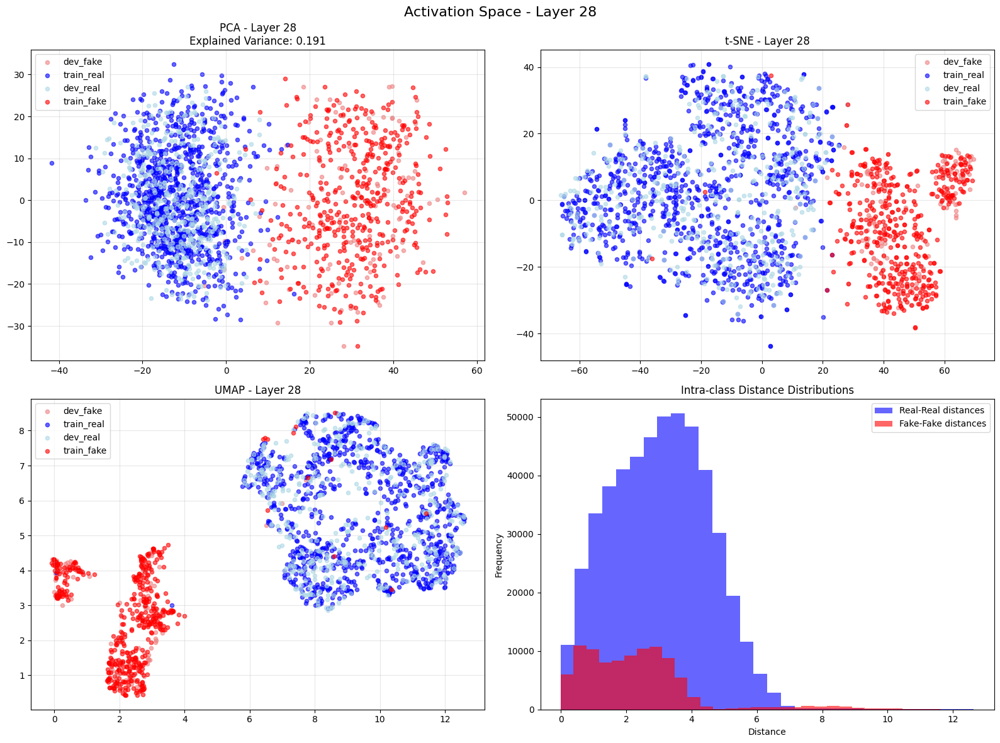

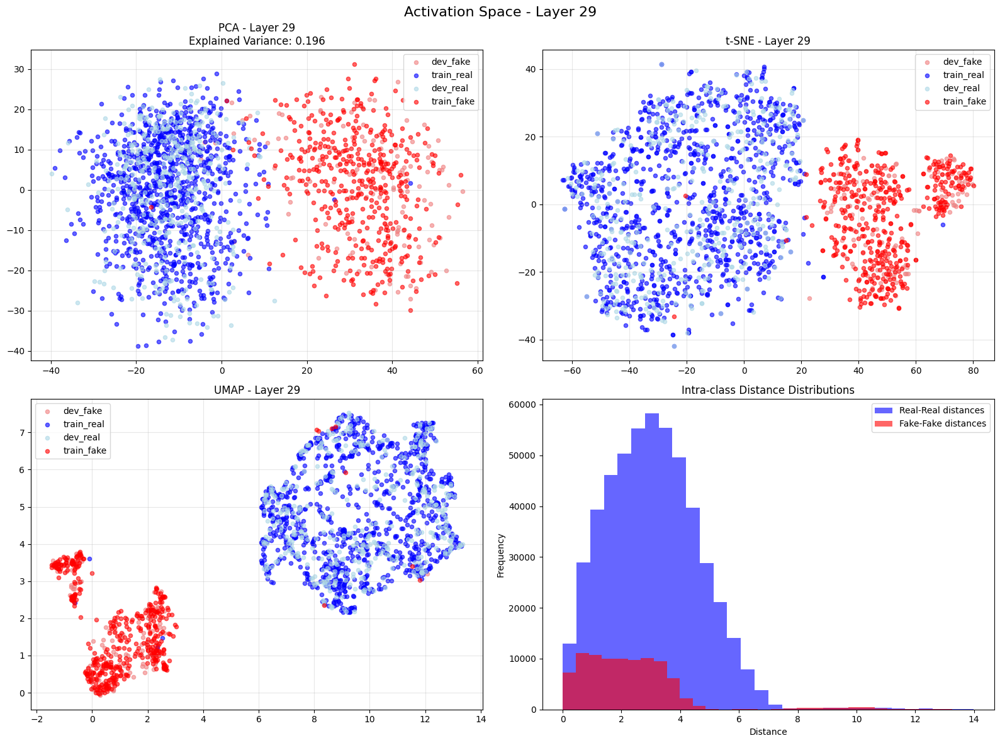

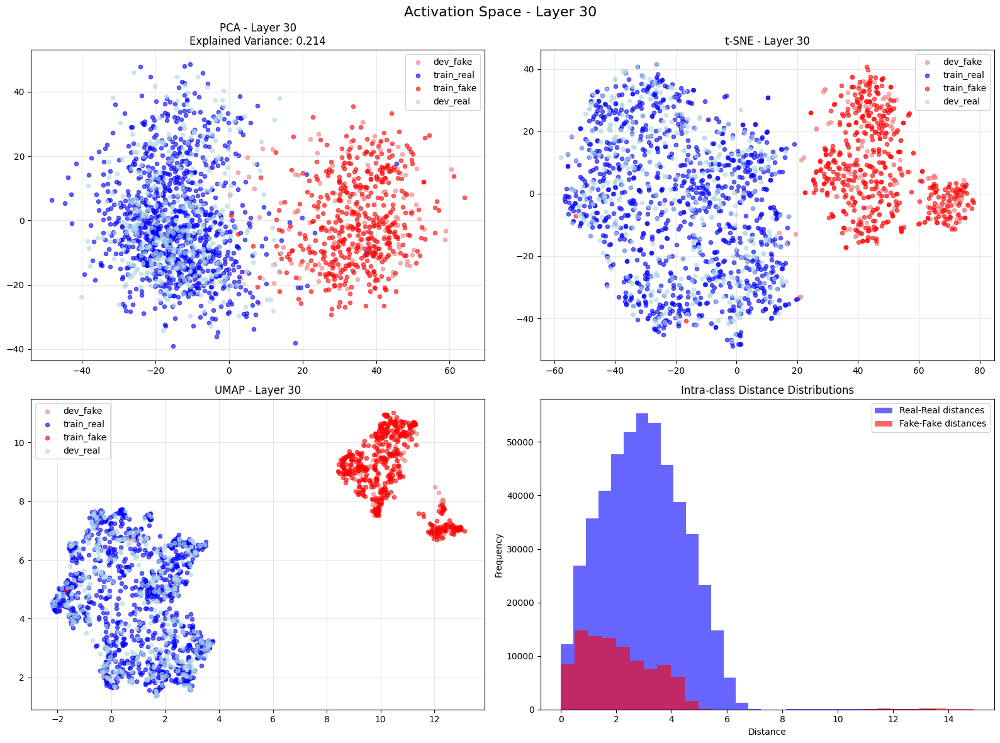

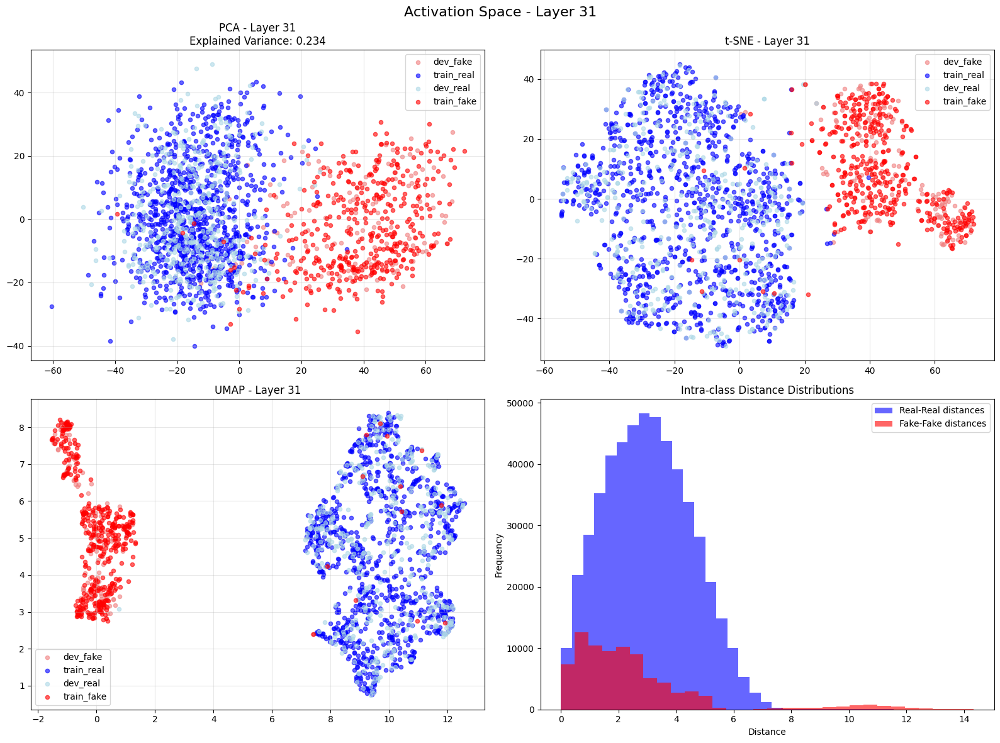

Computed activation space for all 32 layers
Creating combined visualization for 32 layers
Saved combined visualization for PCA to ../visualized_data_from_steering_vectors/steering_visualizations_microsoftPhi2\activation_space_all_layers_pca.png


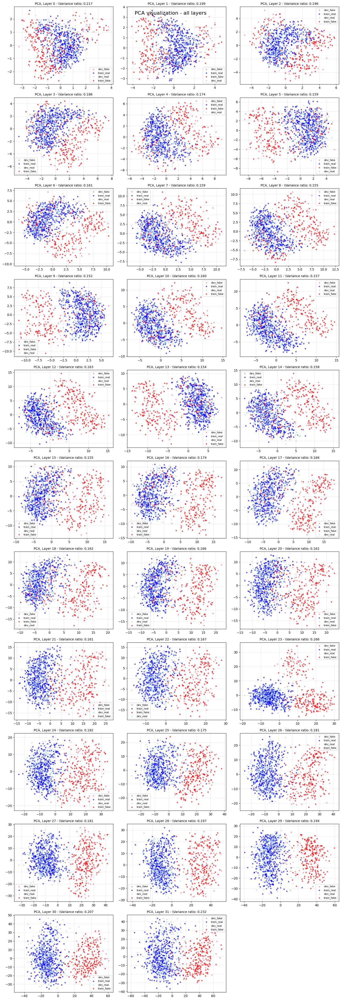

Saved combined visualization for t-SNE to ../visualized_data_from_steering_vectors/steering_visualizations_microsoftPhi2\activation_space_all_layers_t-sne.png


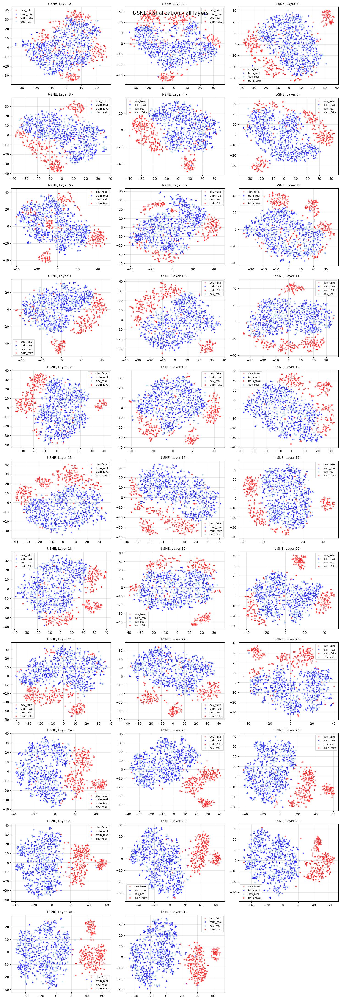

Saved combined visualization for UMAP to ../visualized_data_from_steering_vectors/steering_visualizations_microsoftPhi2\activation_space_all_layers_umap.png


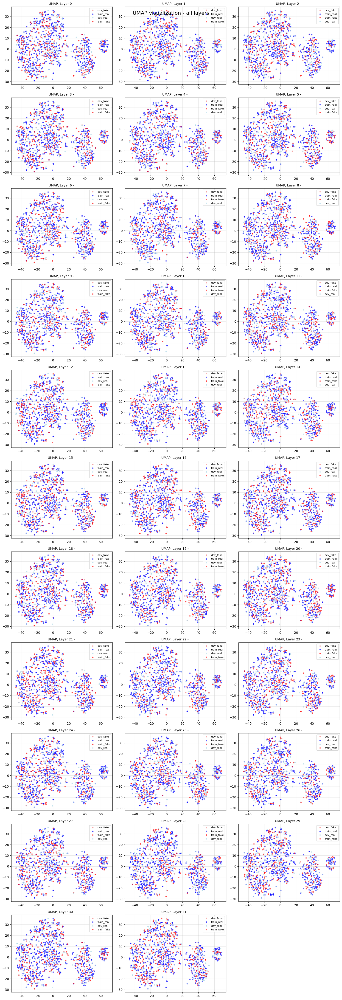

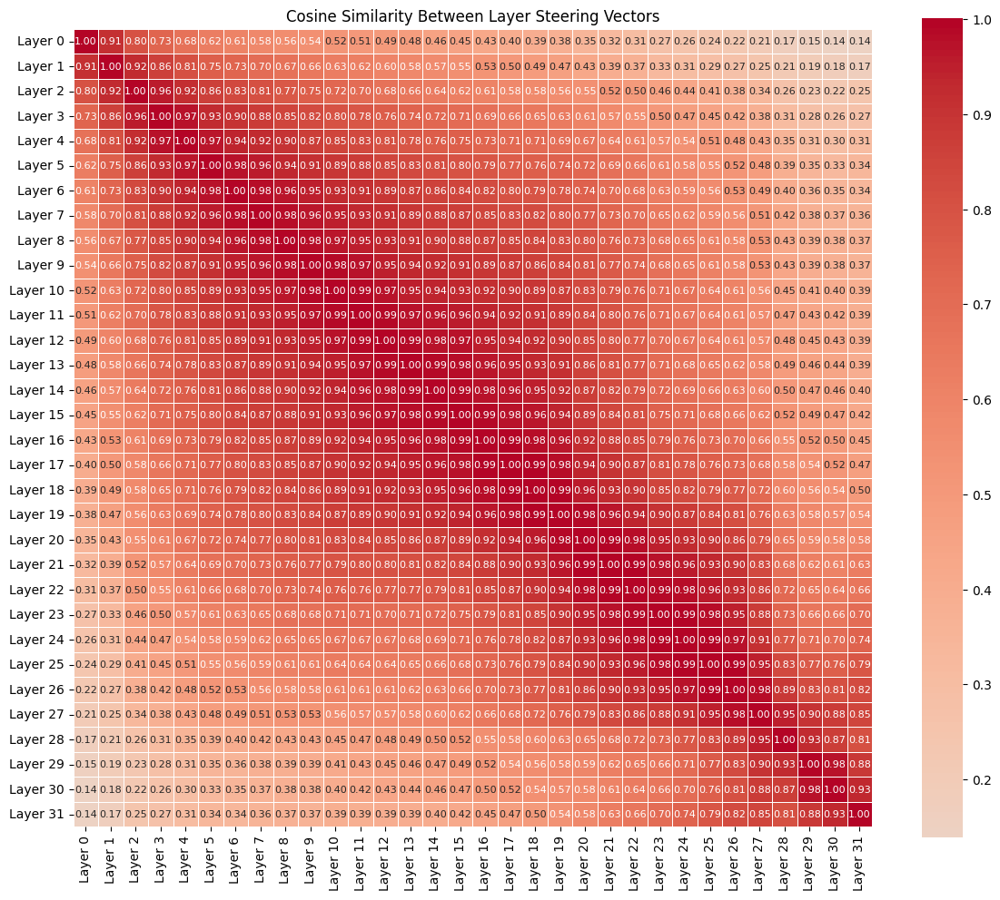

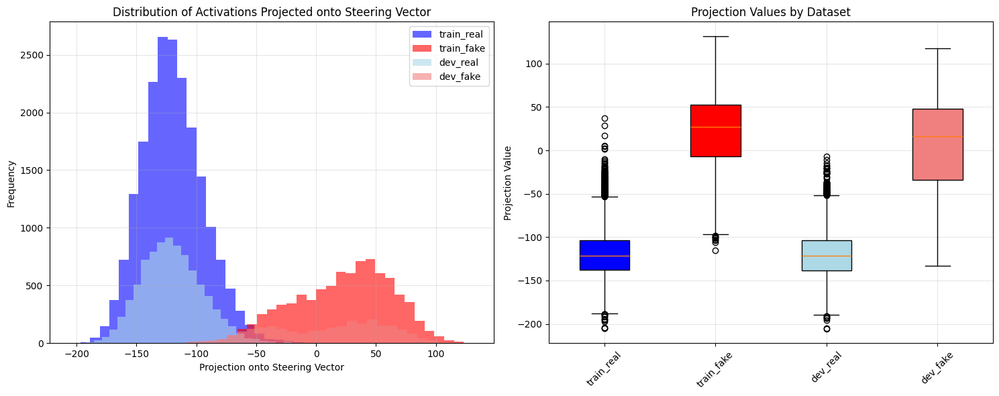


Projection Statistics:
train_real: Mean=-119.7500, Std=inf
train_fake: Mean=22.2500, Std=inf
dev_real: Mean=-120.1250, Std=inf
dev_fake: Mean=8.7578, Std=inf
Visualization completed! Plots saved to: ../visualized_data_from_steering_vectors/steering_visualizations_microsoftPhi2


c:\Users\DarMan\stepik\Projekt_2Sem_DLS\.venv\Lib\site-packages\numpy\_core\_methods.py:171: RuntimeWarning: overflow encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True, where=where)
c:\Users\DarMan\stepik\Projekt_2Sem_DLS\.venv\Lib\site-packages\numpy\_core\_methods.py:205: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)


In [ ]:
visualize_steering_vectors(
        target_dtype=torch.float16,
        results_path="../computed_steering_data/microsoftPhi2_steering_vectors/complete_results.pkl",
        save_plots=True,
        plot_dir="../visualized_data_from_steering_vectors/steering_visualizations_microsoftPhi2")

In [ ]:
#import shutil
#shutil.make_archive('steering_visualizations_microsoftPhi2', 'zip', 'steering_visualizations_microsoftPhi2')

## Выводы по первой части:
- Эта модель показывает немного другую картику: на графике магнитуты виден один сильный скачек в 29 слое. В остальном слои ведут себя довольно одинаково. Это же подтверждает график Layer-to-Layer Similarity: Модель начинает видеть концепт "фейковости" уже с первого слоя.
- Графики PCA, TSNE и UMAP показывают похожую картину как и в эксперименту с llama. UMAP´у не удается хорошо класторизовать тексты. А вот TSNE и PCA показывают лучшую класторизацию, но отличную от грфиков с llama. Интересно также, что внутриклассовая дисперсия по каждому слою у llama была примерно одинаковая, а вот у модели phi-2 они отличаются от слоя к слою - не особо сильно, но отличия заметны.
- Overall Steering Vektor Components также отличается: мы видим большое количество положительных (красный полос) активаций и намного больше нейтральных активаций, а также только одну сильно отрицательную активацию по сравнению с llama.
- Cosinus Similarity Correlation Matrix показывает, что эта модель начинает различать фейковость уже на начальныз слоях. Возморжно это обусловлено размером модели: Она хоть также как и llama имеет 32 слоя, на ее внутренняя размерность меньше, и тем самым у нее меньше обучаемых параметов. А значит один слой должен отвечать за несколько концептов. в Этой модели всего 2.7 миллиарда параметров.

# Часть 2: Вычисление проекций и тренировка полученных результатов на трех классификаторах (логистической регрессии, random forest, SVM)

## Как и в экспериментах с llama-2-7b-hf: Вычисление проекций и тренировка полученных результатов на трех классификаторах (логистической регрессии, random forest, SVM)

### Для этой части исследования я написала функции. Они получились довольно объемными, и для улучшения читаемости я вынесла их, также как и предыдущие функции, в отдельные файл "projection_and_ml_train_function.py" в папке "compute_projection".
    - load_steering_data: загружает раннее созданные данные
    - claculate_projections: вычисляет проекции
    - evaluate_all_layers: оценивает каждый классификатор по отдельности на всех слоях. Использует в себе функции create_classifikation_dataset(), calculate_correlation() и train_classifier().
    - plot_layer_performance(): рисует графики оценки обцчения по каждому слою и выводит топовые значения.

In [ ]:
sys.path.append('../compute_projection') # Путь к папке с модулем compute_projection
from ..compute_projection import load_steering_data, calculate_projections, evaluate_all_layers, plot_layer_performance

Lade Trainingsdaten aus microsoftPhi2_steering_vectors
Lade Entwicklungsdaten aus microsoftPhi2_steering_vectors
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 8663 real, 2643 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in microsoftPhi2_steering_vectors_dotProduct\projections
Evaluating all layers (train & dev)...
Combined results saved to microsoftPhi2_steering_vectors_dotProduct\layer_evaluation_results.csv
Best model: SVM (0.9782)


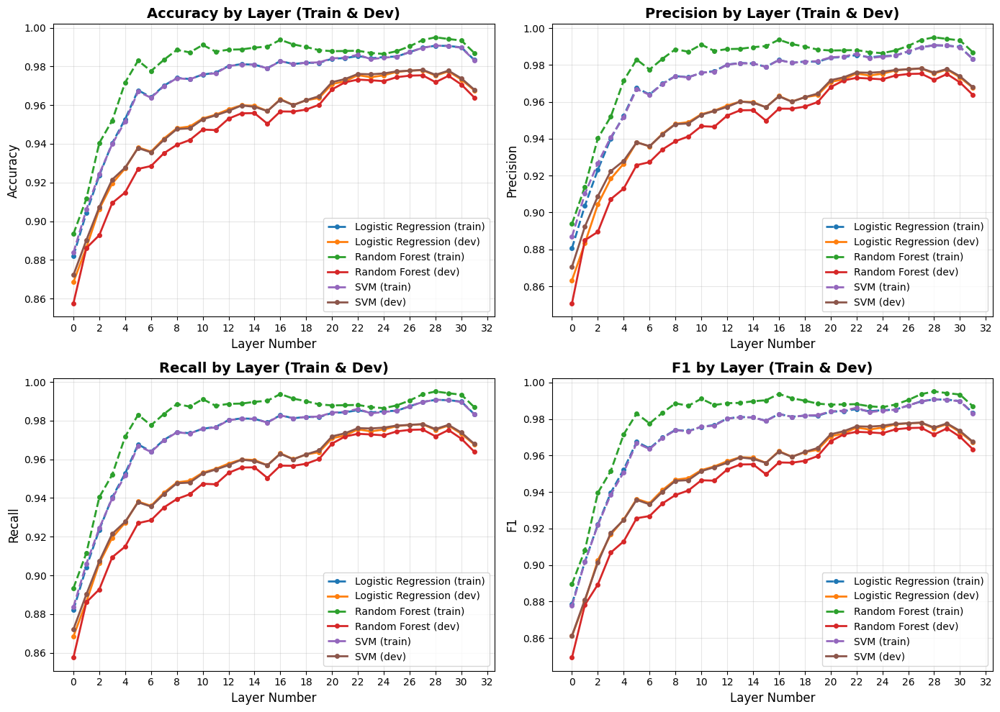

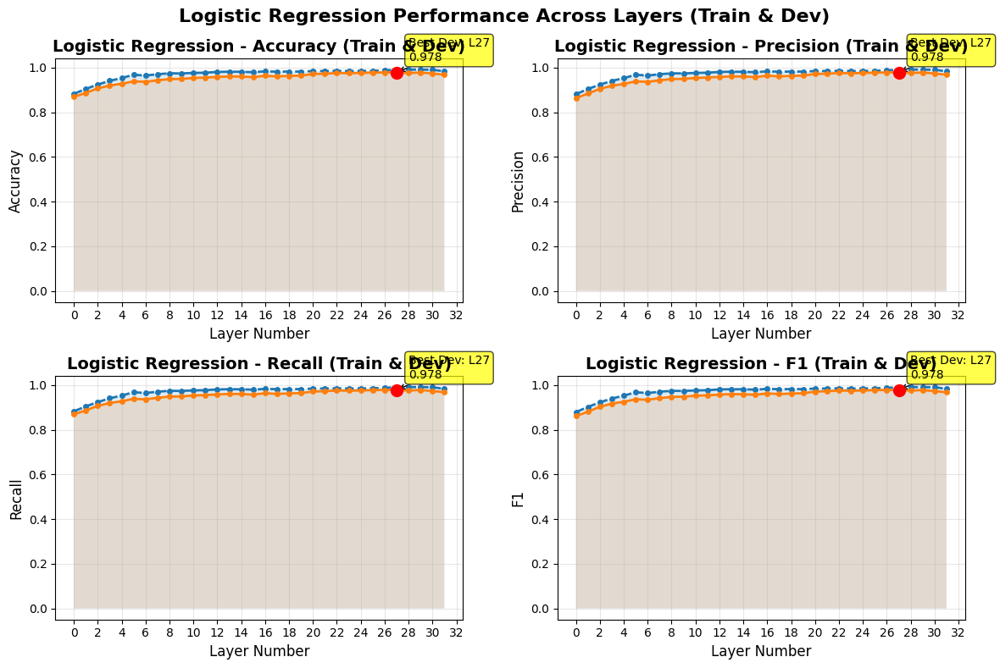

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

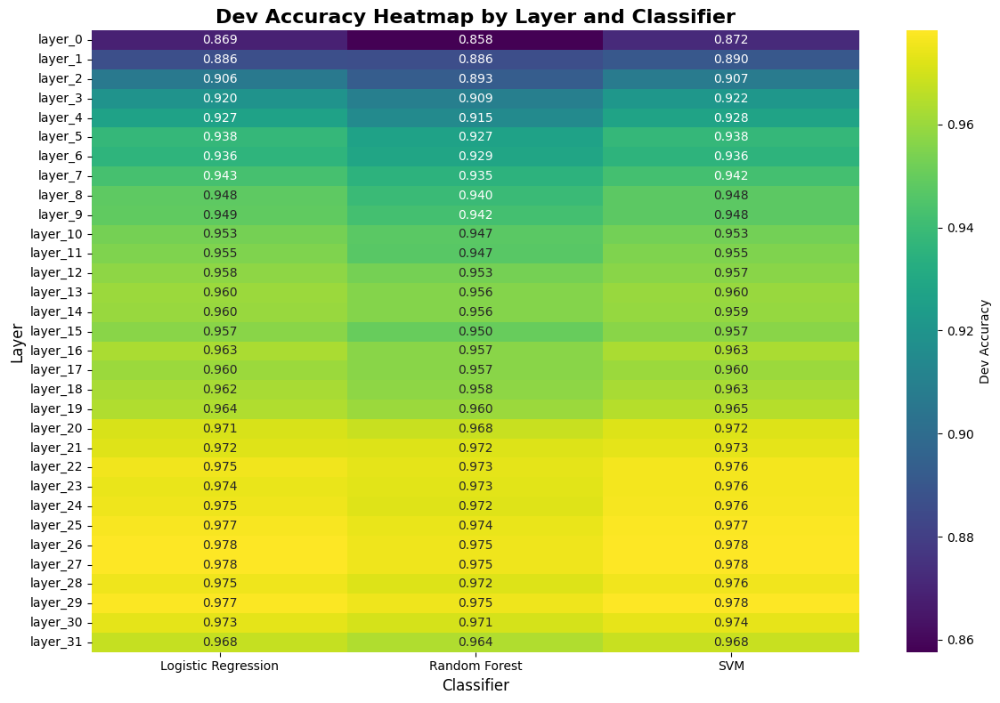

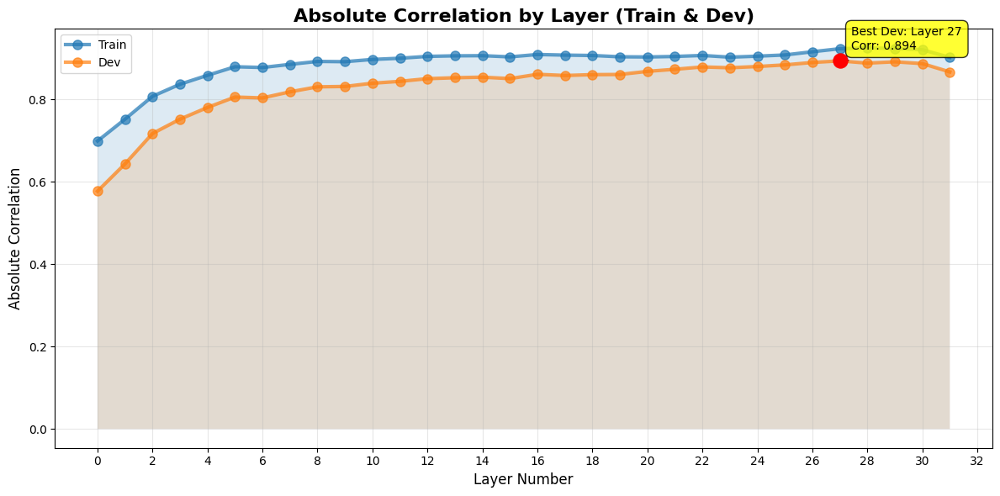

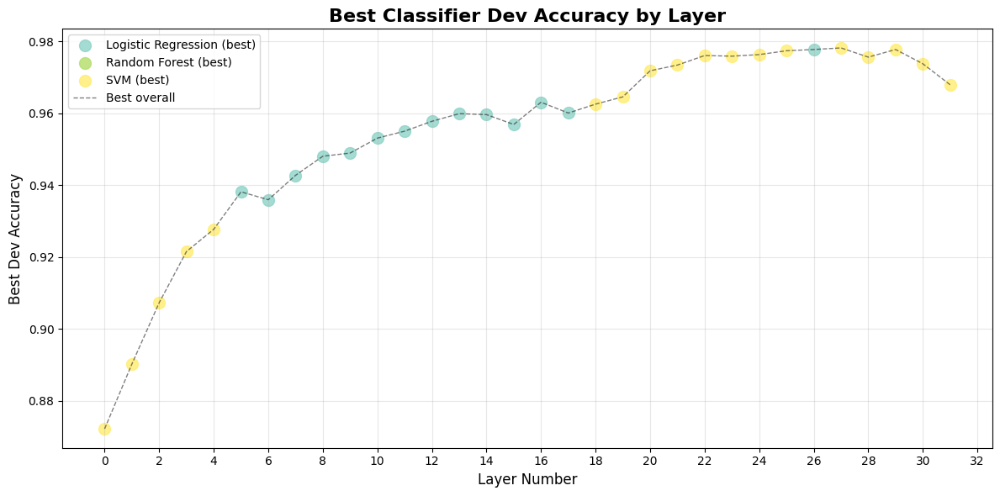

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_27 (Dev Accuracy: 0.9781)
Random Forest: layer_27 (Dev Accuracy: 0.9754)
SVM: layer_27 (Dev Accuracy: 0.9782)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 11306'
'\nBest dev correlation: layer_27 (r=0.8941)'
'Best dev F1 score: layer_27 with SVM (F1=0.9780)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_27                 SVM      0.978242 0.978039             0.894130\n'
 'layer_27 Logistic Regression      0.978065 0.977857             0.894130\n'
 'layer_26 Logistic Regression      0.977799 0.977648             0.890232\n'
 'layer_26                 SVM      0.977799 0.977648             0.890232\n'
 'layer_29                 SVM      0.977799 0.977556             0.891883')
'\nBest train F1 score: layer_28 with Random Forest (F1=0.9951)'


In [ ]:
data_train, data_dev = load_steering_data(save_dir = "../computed_steering_data/microsoftPhi2_steering_vectors")

# Calculate projections
layer_projections_train, layer_projections_dev = calculate_projections(data_train, data_dev, save_dir="../computed_projection_data/microsoftPhi2_steering_vectors_dotProduct")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train, layer_projections_dev, save_dir="../computed_projection_data/microsoftPhi2_steering_vectors_dotProduct")

# Create visualizations
plot_layer_performance(results_df)

print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev['metadata']['dev_real_count'] + data_dev['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

## Выводы из второй части:
- все классификаторы растут от слоя к слою и не переобучаются. По сравнению с llama,  первый слой сильнее всего влияет на результат: улавливает тестируемый концепт и это используется последующими слоями. По heatmap каждого из классификаторов видно, что первый слой достигает >0.85 accuracy на тестовой выборке, что не могkи достичь некоторый среднии слои в llama.
- По топу 5 слоев по классификаторам можно сказать, что у модели phi-2 окончательный результат для высоких метрик кристализируется почти на последних слоях, в отличии от llama, где лучшии метрики показали 16-17 слои.


1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_27 (Dev Accuracy: 0.9781)
    - Random Forest: layer_27 (Dev Accuracy: 0.9754)
    - SVM: layer_27 (Dev Accuracy: 0.9782)

2. Top 5 layers by dev accuracy:

    | layer |  classifier  | dev_accuracy |  dev_f1 |  dev_abs_correlation |
    |-------|--------------|--------------|---------|----------------------|
    |layer_27 |SVM | 0.978242 | 0.978039 | 0.894130|
    |layer_27 |Logistic Regression |0.978065 | 0.977857 | 0.894130|
    |layer_26 |Logistic Regression | 0.977799 | 0.977648 | 0.890232|
    |layer_26 |SVM | 0.977799 | 0.977648 | 0.890232|
    |layer_29 |SVM | 0.977799 | 0.977556 | 0.891883|

    Best train F1 score: layer_28 with Random Forest (F1=0.9951)

In [ ]:
#import shutil
#from google.colab import files
#shutil.make_archive('/content/steering_vectors_dotProduct', 'zip', '/content/steering_vectors_dotProduct')
shutil.make_archive('microsoftPhi2_steering_vectors_dotProduct', 'zip', 'microsoftPhi2_steering_vectors_dotProduct')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steering_vectors_dotProduct.zip'

# Часть 3: Эксперимент-2: перенос домена на тексты медицинского и финансового характера, как  с предыдущей моделью.

In [ ]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["finance"],
                       "dev": ["finance"]}

splits_finance = {"train": None, "dev": None}

for split in splits_finance:
    splits_finance[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_finance[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_finance[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\1629246293.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\1629246293.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 5768
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2414
 })}

### Финансовый датасет буду использовать как тестовое множество, тренинг будет проходить на домене reddit.

In [ ]:
empty_train = Dataset.from_dict({k :[] for k in splits_finance['train'].features})
data_finance = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_finance["train"], splits_finance["dev"]])
}
data_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 8182
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_finance,
        save_dir="../computed_steering_data/microsoftPhi2_steering_vectors_finance",
        max_length=2048,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True,
        device = device
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 3692 real, 4490 fake texts


train: 0 real texts, 0 fake texts
dev: 3692 real texts, 4490 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_finance\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_finance\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 3692 real texts from dev
Processing texts: 100%|██████████| 3692/3692 [01:46<00:00, 34.55it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_finance\dev_real_activations.pkl
INFO:__main__:Processing 4490 fake texts from dev
Processing texts: 100%|██████████| 4490/4490 [02:12<00:00, 33.85it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_finance\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/2 [0

Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 3692
dev_fake_count: 4490
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
#shutil.make_archive('llama_steering_vectors_finance3', 'zip', 'llama_steering_vectors_finance3')
shutil.make_archive('microsoftPhi2_steering_vectors_finance', 'zip', 'microsoftPhi2_steering_vectors_finance')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steering_vectors_finance.zip'

## Подготовка данных как это было проделано в первом эксперименте и создание визуализаций.

Lade Trainingsdaten aus microsoftPhi2_steering_vectors
Lade Entwicklungsdaten aus microsoftPhi2_steering_vectors_finance
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 3692 real, 4490 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in microsoftPhi2_steeringVectors_dotProduct_fromFinance\projections
Evaluating all layers (train & dev)...
Combined results saved to microsoftPhi2_steeringVectors_dotProduct_fromFinance\layer_evaluation_results.csv
Best model: Logistic Regression (0.9919)


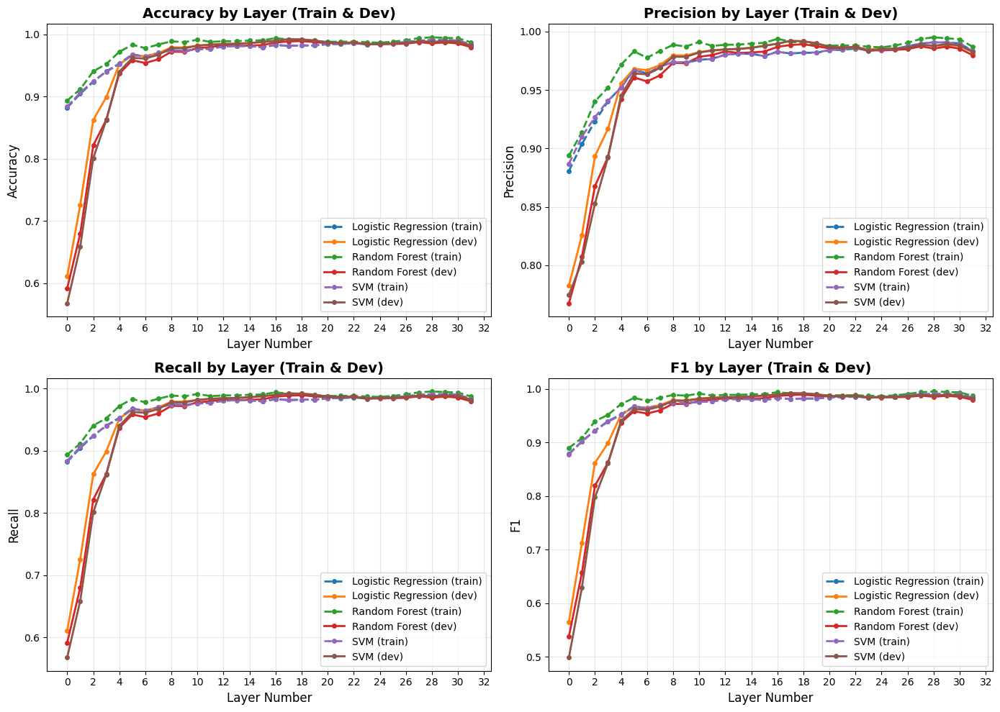

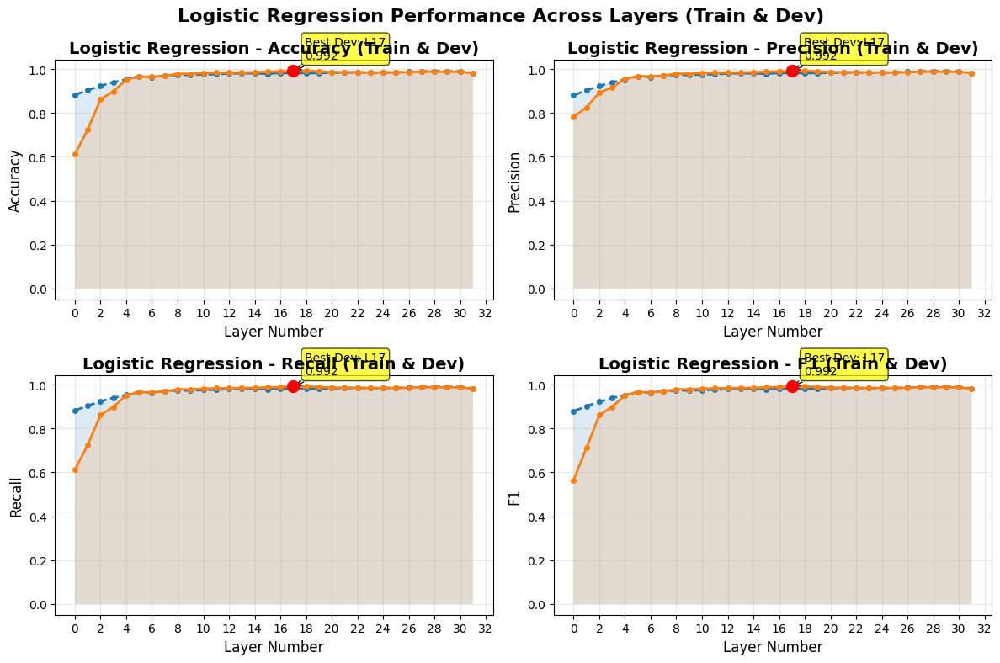

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

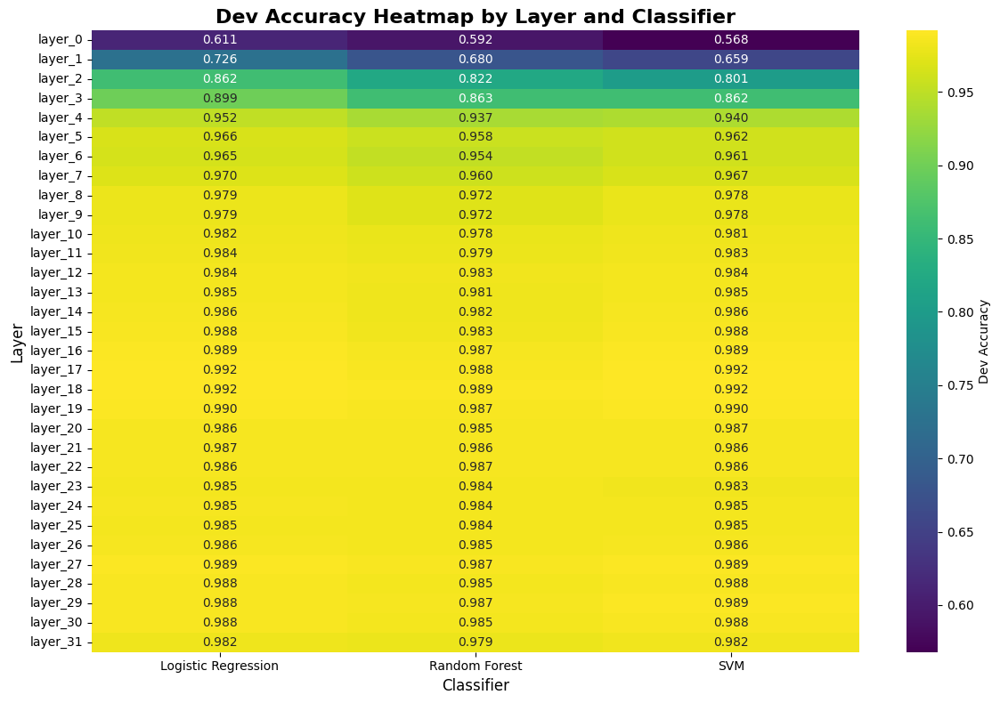

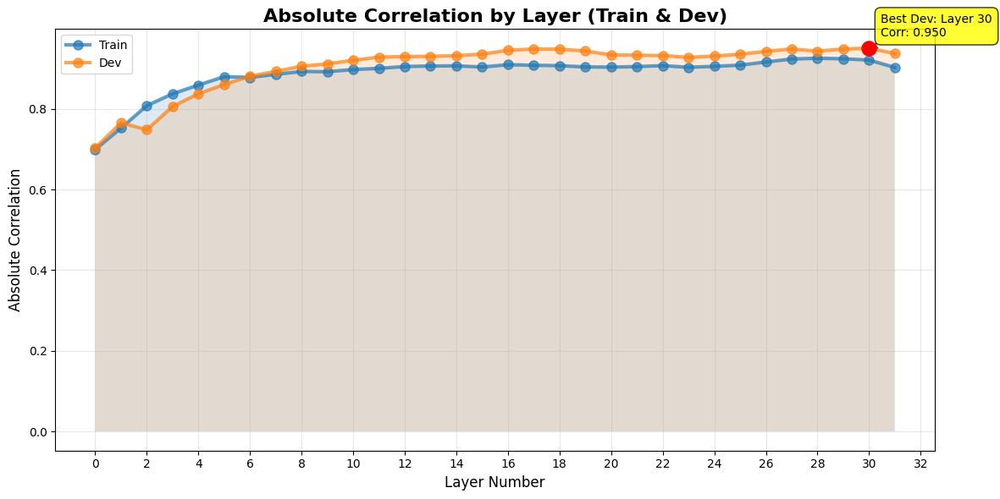

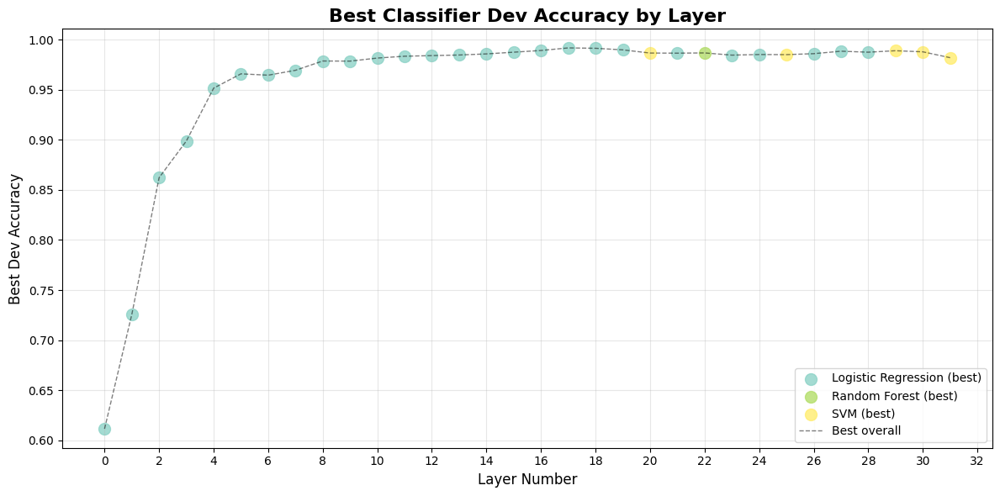

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_17 (Dev Accuracy: 0.9919)
Random Forest: layer_18 (Dev Accuracy: 0.9890)
SVM: layer_17 (Dev Accuracy: 0.9919)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 8182'
'\nBest dev correlation: layer_30 (r=0.9505)'
'Best dev F1 score: layer_17 with Logistic Regression (F1=0.9919)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_17 Logistic Regression      0.991934 0.991938             0.948571\n'
 'layer_17                 SVM      0.991934 0.991938             0.948571\n'
 'layer_18 Logistic Regression      0.991567 0.991571             0.948116\n'
 'layer_18                 SVM      0.991567 0.991571             0.948116\n'
 'layer_19 Logistic Regression      0.989978 0.989983             0.943423')
'\nBest train F1 score: layer_28 with Random Forest (F

In [ ]:
data_train, data_dev_finance = load_steering_data(save_dir = "../computed_steering_data/microsoftPhi2_steering_vectors", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/microsoftPhi2_steering_vectors_finance")

# Calculate projections
layer_projections_train_finance, layer_projections_dev_finance  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/microsoftPhi2_steeringVectors_dotProduct_fromFinance")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_finance, layer_projections_dev_finance, save_dir = "../computed_projection_data/microsoftPhi2_steeringVectors_dotProduct_fromFinance")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_finance['metadata']['dev_real_count'] + data_dev_finance['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

#Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

#Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [ ]:
shutil.make_archive('microsoftPhi2_steeringVectors_dotProduct_fromFinance', 'zip', 'microsoftPhi2_steeringVectors_dotProduct_fromFinance')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steeringVectors_dotProduct_fromFinance.zip'

## Выводы из третий части (перенос на финансовый):
- При переносе домена (from general to specific language) видна похожая картина как и с llama: определенные слои просидают и не привносят данных для детекции концепта на тестируемом домене.
- У модели phi-2 этот феномен проявляется только в самом начале до 5 слоя, после чего ситуация с обучение стабилизируется и классификаторы начинают переобучаться.
- Как и с llama напрашивается гипотеза о неоднородности копцепта "фейковости".
- Необходимо отметить, что здесь метрики даже лучше, чем на первой части - без переноса домена. Особенно это видно по топ 5 слоев: при одном домене это были слои ~27, ну а здесь это ~17 слой.


1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_17 (Dev Accuracy: 0.9919)
    - Random Forest: layer_18 (Dev Accuracy: 0.9890)
     -SVM: layer_17 (Dev Accuracy: 0.9919)

2. Еop 5 layers by dev accuracy:

    | layer | classifier | dev_accuracy | dev_f1 | dev_abs_correlation|
    |-------|--------------|--------------|---------|----------------------|
    | layer_17 | Logistic Regression | 0.991934 | 0.991938 | 0.948571|
    | layer_17 | SVM     | 0.991934 | 0.991938 | 0.948571|
    | layer_18 | Logistic Regression | 0.991567 | 0.991571 | 0.948116
    | layer_18 | SVM |0.991567 | 0.991571 | 0.948116|
    | layer_19 |Logistic Regression | 0.989978 | 0.989983 |0.943423|

    Best train F1 score: layer_19 with Random Forest (F1=0.9880)

## Перенос на медицинские данные:

In [ ]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["medicine"],
                       "dev": ["medicine"]}

splits_medicine = {"train": None, "dev": None}

for split in splits_medicine:
    splits_medicine[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_medicine[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_medicine[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\2066332619.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_3884\2066332619.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 1769
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 732
 })}

In [ ]:
empty_train = Dataset.from_dict({k :[] for k in splits_medicine['train'].features})
data_medicine = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_medicine["train"], splits_medicine["dev"]])
}
data_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2501
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_medicine,
        save_dir="../computed_steering_data/microsoftPhi2_steering_vectors_medicine",
        max_length=2048,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 1238 real, 1263 fake texts


train: 0 real texts, 0 fake texts
dev: 1238 real texts, 1263 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_medicine\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_medicine\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 1238 real texts from dev
Processing texts: 100%|██████████| 1238/1238 [00:32<00:00, 38.27it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_medicine\dev_real_activations.pkl
INFO:__main__:Processing 1263 fake texts from dev
Processing texts: 100%|██████████| 1263/1263 [00:36<00:00, 34.97it/s]
INFO:__main__:Saving activations to microsoftPhi2_steering_vectors_medicine\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/

Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 1238
dev_fake_count: 1263
max_length: 2048
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
shutil.make_archive('microsoftPhi2_steering_vectors_medicine', 'zip', 'microsoftPhi2_steering_vectors_medicine')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steering_vectors_medicine.zip'

Lade Trainingsdaten aus microsoftPhi2_steering_vectors
Lade Entwicklungsdaten aus microsoftPhi2_steering_vectors_medicine
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 1238 real, 1263 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in microsoftPhi2_steeringVectors_dotProduct_fromMedicine\projections
Evaluating all layers (train & dev)...
Combined results saved to microsoftPhi2_steeringVectors_dotProduct_fromMedicine\layer_evaluation_results.csv
Best model: Logistic Regression (0.9919)


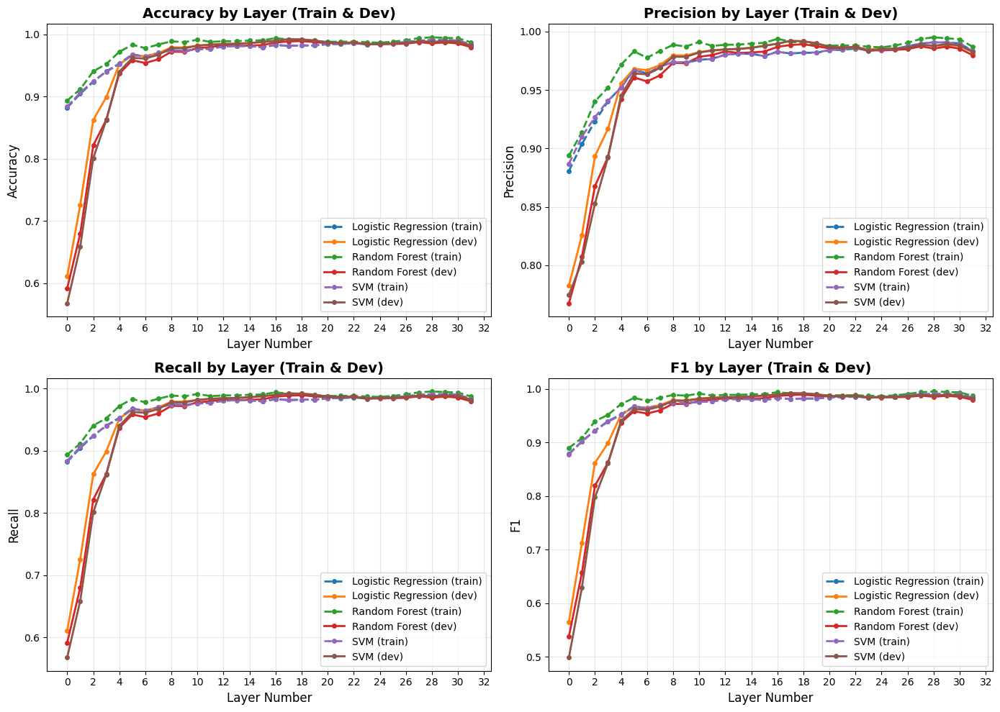

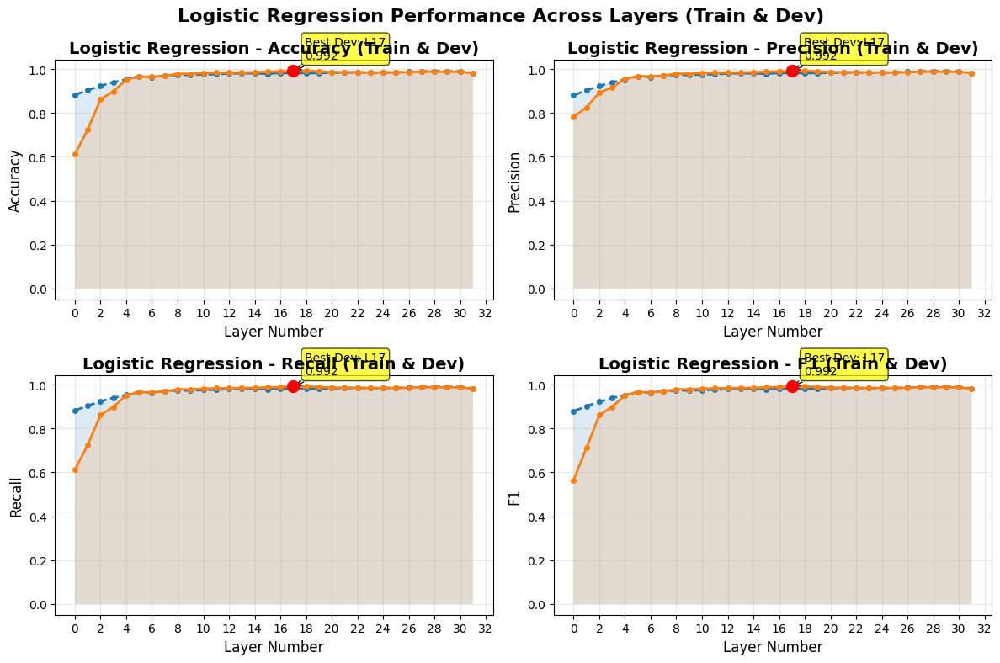

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

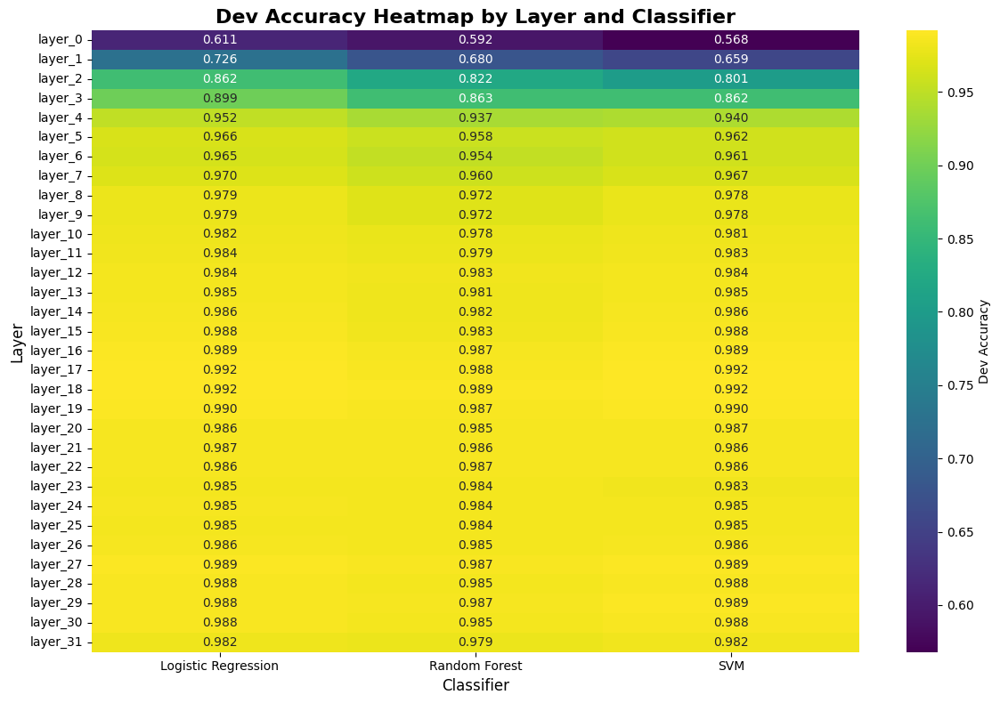

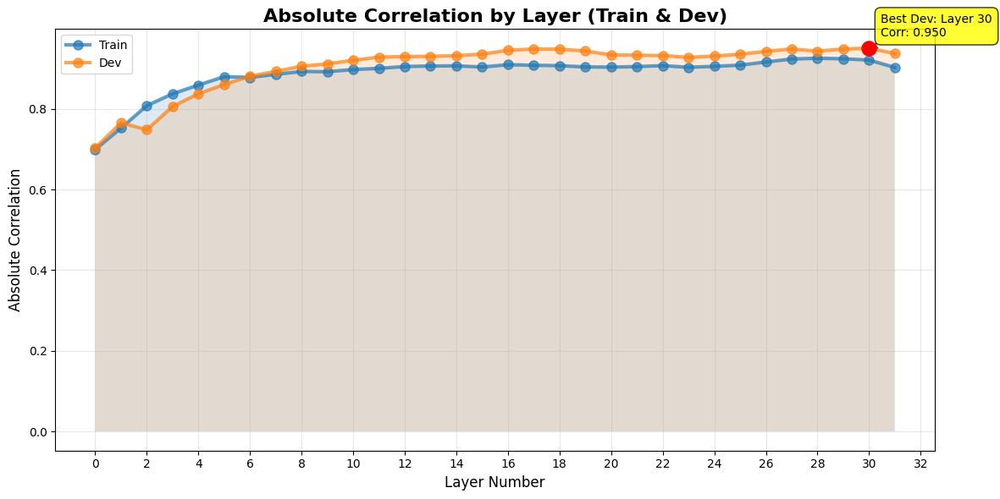

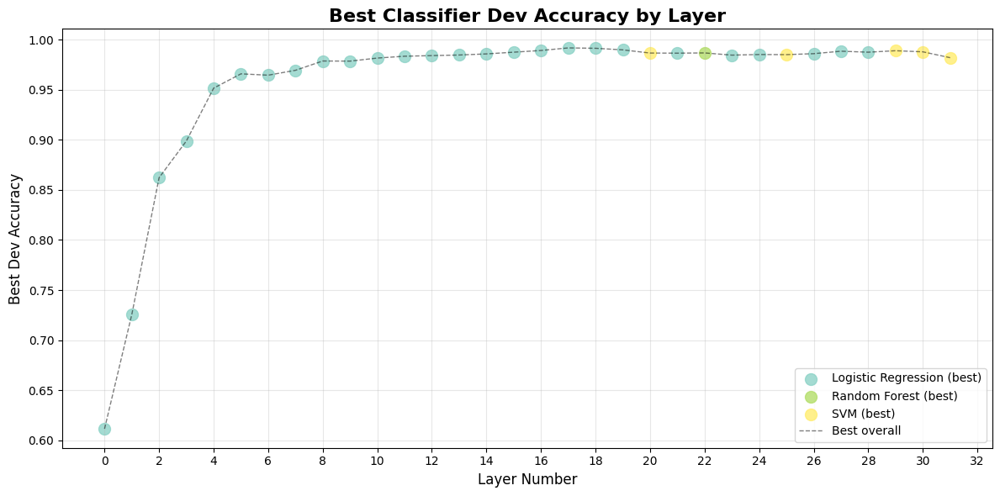

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_17 (Dev Accuracy: 0.9919)
Random Forest: layer_18 (Dev Accuracy: 0.9890)
SVM: layer_17 (Dev Accuracy: 0.9919)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 2501'
'\nBest dev correlation: layer_30 (r=0.9505)'
'Best dev F1 score: layer_17 with Logistic Regression (F1=0.9919)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_17 Logistic Regression      0.991934 0.991938             0.948571\n'
 'layer_17                 SVM      0.991934 0.991938             0.948571\n'
 'layer_18 Logistic Regression      0.991567 0.991571             0.948116\n'
 'layer_18                 SVM      0.991567 0.991571             0.948116\n'
 'layer_19 Logistic Regression      0.989978 0.989983             0.943423')
'\nBest train F1 score: layer_28 with Random Forest (F

In [ ]:
data_train, data_dev_medicine = load_steering_data(save_dir = "../computed_steering_data/microsoftPhi2_steering_vectors", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/microsoftPhi2_steering_vectors_medicine")

# Calculate projections
layer_projections_train_medicine, layer_projections_dev_medicine  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/microsoftPhi2_steeringVectors_dotProduct_fromMedicine")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_medicine, layer_projections_dev_medicine, save_dir = "../computed_projection_data/microsoftPhi2_steeringVectors_dotProduct_fromMedicine")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_medicine['metadata']['dev_real_count'] + data_dev_medicine['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

#Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers оn Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [ ]:
shutil.make_archive('microsoftPhi2_steeringVectors_dotProduct_fromMedicine', 'zip', 'microsoftPhi2_steeringVectors_dotProduct_fromMedicine')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\microsoftPhi2_steeringVectors_dotProduct_fromMedicine.zip'

## Выводы из третий части (перенос на медицинский домен):
- Ситуация аналогична эксперименту с финансовыми данными: Метрики остались такими же и графики никак не поменялись.

# Основной вывод из первой части с моделью llama-2-7b:
Эксперимент с моделью phi-2 выявил ряд отличий в обработке концепта "фейковости" по сравнению с llama. В phi-2 модель начинает различать целевой концепт уже с первых слоёв, причём первый слой сразу даёт высокий вклад в детекцию (accuracy > 0.85 на тесте), чего не наблюдалось у llama. В целом, большинство слоёв phi-2 ведут себя схоже, за исключением одного ярко выраженного скачка по магнитуде в 29-м слое. Это подтверждается и анализом Layer-to-Layer Similarity: модель с самого начала чувствительна к "фейковости".

Методы визуализации (PCA, t-SNE, UMAP) показали, что phi-2 формирует кластеры иначе, чем llama: t-SNE и PCA дают хорошую кластеризацию, но с иной структурой, а UMAP работает хуже. Внутриклассовая дисперсия по слоям у phi-2 заметно варьируется, а структура активаций отличается большим числом положительных и нейтральных компонент и лишь одной сильно отрицательной активацией.

Среди классификаторов все модели демонстрируют стабильный рост метрик от слоя к слою без переобучения. В отличие от llama, где лучшие результаты достигались в середине сети (16–17 слои), у phi-2 максимальные показатели точности и F1 достигаются на последних слоях (26–29). Это, вероятно, связано с меньшей размерностью phi-2: один слой отвечает сразу за несколько концептов.

При переносе на финансовый и медицинский домены наблюдается схожая тенденция: вклад начальных слоёв резко снижается, но уже после 5-го слоя обучение стабилизируется. Интересно, что в этих специализированных задачах лучшие метрики достигаются на более ранних слоях (около 17-го), а сами метрики оказываются даже выше, чем в исходной задаче. Это дополнительно подтверждает гипотезу о неоднородности концепта "фейковости" и его доменной специфичности.

В целом, phi-2 демонстрирует более раннюю и стабильную чувствительность к концепту "фейковости" по сравнению с llama, а структура вклада слоёв и динамика метрик зависят как от архитектуры модели, так и от специфики задачи и домена.